In [1]:
import os
import glob
import shutil

file_list = glob.glob('datasets/guro0405/images/db/*.png')
db = []
for file in file_list:
    if int(file.split('/')[-1].split('.')[0])%80 == 0:
        db.append(file)

os.mkdir(os.getcwd()+'/datasets/guro0405/images/db_80')
for file in db:
    num = file.split('/')[-1].split('.')[0]
    os.symlink(os.getcwd()+'/'+file.split('.')[0]+'.txt', 'datasets/guro0405/images/db_80/'+num+'.txt')
    os.symlink(os.getcwd()+'/'+file.split('.')[0]+'.tiff', 'datasets/guro0405/images/db_80/'+num+'.tiff')
    os.symlink(os.getcwd()+'/'+file, 'datasets/guro0405/images/db_80/'+num+'.png')

In [1]:
from pathlib import Path
from pprint import pformat

from hloc import (
    extract_features,
    match_features,
    localize_guro,
    visualization,
    pairs_from_retrieval,
)

from hloc.visualization import plot_images, read_image, visualize_loc, visualize_loc_3d, visualize_loc_3d_kgnet
import numpy as np

[2024/07/03 16:31:44 hloc WARNING] hloc requires pycolmap>=0.6.0 but found pycolmap==0.4.0, please upgrade with `pip install --upgrade "pycolmap>=0.6.0"`


Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


# Setup

In [2]:
dataset = Path("datasets/guro0405/")
images = Path("datasets/guro0405/images/")
# queries = Path("datasets/guro/query0/")

pairs = Path("pairs/guro0405/")
loc_pairs = pairs / "pairs-query0628-netvlad20.txt"  # top-k retrieved by NetVLAD

outputs = Path("outputs/guro0405/")  # where everything will be saved
results_linear_5 = outputs / "guro_hloc_superpoint+lightglue_netvlad5_linear.txt"  # the result file
results_cubic_5 = outputs / "guro_hloc_superpoint+lightglue_netvlad5_cubic.txt"  # the result file
results_nn_5 = outputs / "guro_hloc_superpoint+lightglue_netvlad5_nn.txt"  # the result file
results_linear = outputs / "guro_hloc_superpoint+lightglue_netvlad_linear.txt"  # the result file
results_cubic = outputs / "guro_hloc_superpoint+lightglue_netvlad_cubic.txt"  # the result file
results_nn = outputs / "guro_hloc_superpoint+lightglue_netvlad_nn.txt"  # the result file
results = outputs / "guro_hloc_superpoint+lightglue_kgnet_netvlad.txt"  # the result file

In [4]:
# # list the standard configurations available
# print(f"Configs for feature extractors:\n{pformat(extract_features.confs)}")
# print(f"Configs for feature matchers:\n{pformat(match_features.confs)}")

In [5]:
# images = Path("/home/yunho/guro_db_zed_colmap/images/")

# outputs = Path("/home/yunho/guro_db_zed_colmap/outputs/sfm/")
# sfm_pairs = outputs / "pairs-netvlad.txt"
# sfm_dir = outputs / "sfm_superpoint+lightglue"

# retrieval_conf = extract_features.confs["netvlad"]
retrieval_conf = extract_features.confs["netvlad"]
feature_conf = extract_features.confs["superpoint_inloc"]
matcher_conf = match_features.confs["superpoint+lightglue"]

# Find image pairs via image retrieval

In [5]:
# retrieval_conf = extract_features.confs["netvlad320"]
descriptor_path = extract_features.main(retrieval_conf, images, outputs)

[2024/07/03 14:00:07 hloc INFO] Extracting local features with configuration:
{'model': {'name': 'netvlad'},
 'output': 'global-feats-netvlad',
 'preprocessing': {'resize_max': 1024}}
[2024/07/03 14:00:07 hloc INFO] Found 5093 images in root datasets/guro0405/images.
[2024/07/03 14:00:07 hloc INFO] Skipping the extraction.


In [6]:
pairs_from_retrieval.main(descriptor_path, loc_pairs, num_matched=20, query_prefix="query628", db_prefix="db")

[2024/07/03 14:00:26 hloc INFO] Extracting image pairs from a retrieval database.
[2024/07/03 14:00:27 hloc INFO] Found 32520 pairs.


# Extract and match local features

In [7]:
# feature_conf = extract_features.confs["superpoint_inloc"]
# feature_path = extract_features.main(feature_conf, Path("datasets/guro0405/images/db/"), outputs, depth=True)

In [8]:
feature_conf = extract_features.confs["superpoint_inloc512"]
feature_path = extract_features.main(feature_conf, images, outputs)

[2024/07/03 14:00:29 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 512, 'name': 'superpoint', 'nms_radius': 4},
 'output': 'feats-superpoint-n512-r1600',
 'preprocessing': {'grayscale': True, 'resize_max': 1600}}
[2024/07/03 14:00:29 hloc INFO] Found 5093 images in root datasets/guro0405/images.
[2024/07/03 14:00:29 hloc INFO] Skipping the extraction.


In [9]:
# import h5py
# fd = h5py.File('/home/yunho/Hierarchical-Localization/outputs/colo/feats-superpoint-n4096-r1600.h5', 'r')
# num_keypoints = []
# for key in fd['db'].keys():
#     num_keypoints.append(fd['db'][key]['keypoints'].shape[0])
# np.array(num_keypoints).min(), np.array(num_keypoints).mean(), np.array(num_keypoints).max()
    

In [10]:
match_path = match_features.main(
    matcher_conf, loc_pairs, feature_conf["output"], outputs
)

[2024/07/03 14:00:33 hloc INFO] Matching local features with configuration:
{'model': {'features': 'superpoint', 'name': 'lightglue'},
 'output': 'matches-superpoint-lightglue'}
100%|████████████████████████████████████| 16260/16260 [01:44<00:00, 155.09it/s]
[2024/07/03 14:02:18 hloc INFO] Finished exporting matches.


# Localize

In [26]:
from hloc import localize_guro

In [11]:
images, feature_path, match_path, loc_pairs, results_linear_5

(PosixPath('datasets/guro0405/images'),
 PosixPath('outputs/guro0405/feats-superpoint-n512-r1600.h5'),
 PosixPath('outputs/guro0405/feats-superpoint-n512-r1600_matches-superpoint-lightglue_pairs-query0628-netvlad20.h5'),
 PosixPath('pairs/guro0405/pairs-query0628-netvlad20.txt'),
 PosixPath('outputs/guro0405/guro_hloc_superpoint+lightglue_netvlad5_linear.txt'))

In [12]:
localize_guro.main(images, loc_pairs, feature_path, match_path, results_linear_5, interp='linear')
pos_err, angle_err, recall = localize_guro.eval_performance(results_linear_5, images)
np.median(pos_err), np.median(angle_err), recall

[2024/07/03 14:02:24 hloc INFO] Starting localization...
  0%|                                          | 2/1626 [00:00<11:33,  2.34it/s]/home/yunho/Hierarchical-Localization/hloc/localize_guro.py:338: RuntimeWarning: invalid value encountered in matmul
  all_rp3d = np.matmul(all_rp3d_cam, rmat.T) + t_w2c
100%|███████████████████████████████████████| 1626/1626 [11:38<00:00,  2.33it/s]
[2024/07/03 14:14:03 hloc INFO] Writing poses to outputs/guro0405/guro_hloc_superpoint+lightglue_netvlad5_linear.txt...
[2024/07/03 14:14:03 hloc INFO] Writing logs to outputs/guro0405/guro_hloc_superpoint+lightglue_netvlad5_linear.txt_logs.pkl...
[2024/07/03 14:14:03 hloc INFO] Done!


FileNotFoundError: [Errno 2] No such file or directory: 'datasets/guro0405/images/query628/832.txt'

In [11]:
pos_err, angle_err, recall = localize_guro.eval_performance(results_linear_5, images)
np.median(pos_err), np.median(angle_err), recall

Top-5 largest error queries:  ['query2/155.png', 'query2/140.png', 'query2/154.png', 'query2/291.png', 'query2/223.png']
pos mae: 0.051 angle mae: 0.796
pos rmse: 0.063 angle rmse: 1.155


(0.04583172498889232,
 0.545466303653552,
 array([0.5973025 , 0.96339114, 0.99807322, 0.99807322, 1.        ]))

In [ ]:
localize_guro.main(images, loc_pairs, feature_path, match_path, results_cubic, interp='cubic')

In [ ]:
localize_guro.main(images, loc_pairs, feature_path, match_path, results_nn, interp='nn')

In [ ]:
localize_guro.main_kgnet('hloc/habitat/weights/depth.16.pth', images, loc_pairs, results, interp='linear')

In [ ]:
localize_guro.main_kgnet('hloc/habitat/weights/mixed44.pth', images, loc_pairs, results, interp='linear')

[2024/05/07 15:52:45 hloc INFO] Starting localization...
  0%|                                                         | 0/492 [00:00<?, ?it/s]

> /home/yunho/Hierarchical-Localization/hloc/habitat/kgnet.py(121)forward()
    119         pdb.set_trace()
    120 
--> 121         self.extractor.eval()
    122         self.matcher.eval()
    123         with torch.no_grad():

ipdb> image0.shape
torch.Size([1, 3, 720, 1280])
ipdb> image1.shape
torch.Size([1, 3, 720, 1280])
ipdb> depth1.shape
*** AttributeError: 'NoneType' object has no attribute 'shape'
ipdb> n_batch
1


# 2D Visualization

In [ ]:
visualize_loc(results_linear_5, images, n=10, top_k_db=1, seed=2)

In [ ]:
visualize_loc(results_cubic, images, n=1, top_k_db=1, seed=2)

In [ ]:
visualize_loc(results_nn, images, n=1, top_k_db=1, seed=2)

# 3D Visualization
- visualize_loc_3d(result, pcd_dir, images, n, top_k_db, seed, K, ps, size, width, inverval, remove_ceiling)
  - n: # of query image to visualize
  - top_k_db: k of the top-k retrieved images to visualize its camera pose and image matching 
  - seed: random seed to sample queries. If seed=-1, sample from the query trajectory sequentially with interval.
  - K: camera matrix
  - ps: point size when visualizing point clouds
  - size: size of the camera frustum.
  - width: width of the lines in the camera frustum
  - remove_ceiling: boolean to decide whether the ceiling is visualized or not.
  

In [3]:
pcd_dir = dataset / "pointcloud_w_color.pcd"
K = np.array([[526.5249633789062, 0.0,  651.398681640625],
               [0.0, 526.5249633789062, 360.3771057128906],
               [0.0,               0.0,               1.0]])
# K = np.array([[263.27886962890625, 0.0, 325.6990051269531],
#               [0.0, 263.27886962890625, 180.189453125],
#               [0.0, 0.0, 1.0 ]])

In [ ]:
visualize_loc_3d(results_cubic, pcd_dir, images, n=1, top_k_db=5, seed=2, K=K, ps=2, size=5, width=3)

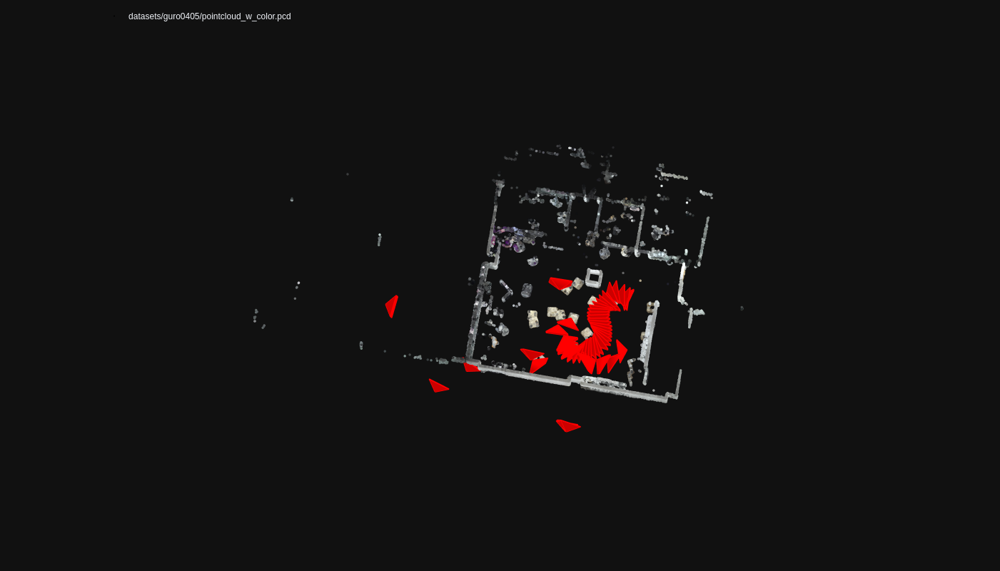

In [23]:
visualize_loc_3d(results_linear_5, pcd_dir, images, n=51, top_k_db=0, seed=-1, K=K, ps=2, size=5, width=3, interval=10, remove_ceiling=True)

In [ ]:
visualize_loc_3d(results_linear_5, pcd_dir, images, n=50, top_k_db=0, seed=-1, K=K, ps=2, size=5, width=3, interval=1, remove_ceiling=True)

In [ ]:
visualize_loc_3d(results_linear_5, pcd_dir, images, n=10, top_k_db=0, seed=-1, K=K, ps=2, size=5, width=3, interval=10, remove_ceiling=True)

In [ ]:
from hloc.visualization import *
import plotly.graph_objects as go
from PIL import Image

n=160 #51
top_k_db=0
seed=-1
K=K
ps=2
size=5
width=3
interval=10 #10
remove_ceiling=True
ceiling_height=2
downsample=100
selected=[]
prefix=None
results = results_linear_5
image_dir = images

pcd = o3d.io.read_point_cloud(str(pcd_dir))
num_points = np.asarray(pcd.points).shape[0]
ind = np.arange(num_points)
np.random.shuffle(ind)
ind = ind[:num_points//downsample]
points = np.asarray(pcd.points)[ind,:]
colors = np.asarray(pcd.colors)[ind,:]
if remove_ceiling:
    colors = colors[points[:,2]<ceiling_height]
    points = points[points[:,2]<ceiling_height]
    
fig = go.FigureWidget()
axes = dict(
    visible=False,
    showbackground=False,
    showgrid=False,
    showline=False,
    showticklabels=True,
    autorange=True,
)
fig.update_layout(
    template="plotly_dark",
    height=800,
    scene_camera=dict(
        eye=dict(x=0.0, y=-0.1, z=-2),
        up=dict(x=0, y=-1.0, z=0),
        projection=dict(type="orthographic"),
    ),
    scene=dict(
        xaxis=axes,
        yaxis=axes,
        zaxis=axes,
        aspectmode="data",
        dragmode="orbit",
    ),
    margin=dict(l=0, r=0, b=0, t=0, pad=0),
    legend=dict(orientation="h", yanchor="top", y=0.99, xanchor="left", x=0.1),
)

img_width = 1280
img_height = 720
scale_factor = 0.0004
fig.add_layout_image(
    dict(
        x=0.02,
        y=img_height * scale_factor * 1.25,
        sizex=img_width * scale_factor,
        sizey=img_height * scale_factor,
#         xref="x domain",
#         yref="y domain",
        opacity=1.0,
        layer="above",
#         sizing="stretch",
        source="https://raw.githubusercontent.com/michaelbabyn/plot_data/master/bridge.jpg")
)
fig.add_layout_image(
    dict(
        x=0.02,
        y=img_height * scale_factor * 2.5,
        sizex=img_width * scale_factor,
        sizey=img_height * scale_factor,
#         xref="x domain",
#         yref="y domain",
        opacity=1.0,
        layer="above",
#         sizing="stretch",
        source="https://raw.githubusercontent.com/michaelbabyn/plot_data/master/bridge.jpg")
)

plot_points(fig, points, colors, ps=ps, name=str(pcd_dir));
fig

In [15]:
with open(str(results) + "_logs.pkl", "rb") as f:
    logs = pickle.load(f)

if not selected:
    queries = list(logs["loc"].keys())
    if prefix:
        queries = [q for q in queries if q.startswith(prefix)]
    if seed == -1:
        q_num = np.array([int(q.split('.')[0].split('/')[1]) for q in queries])
        selected = np.asarray(queries)[q_num.argsort()][0:min(interval*n, len(queries)):interval].tolist()
    else:
        selected = random.Random(seed).sample(queries, min(n, len(queries)))

# selected = selected[20:]
        
for qname in selected:
    loc = logs["loc"][qname]
#     fig.layout['images']=[]
    fig.update_layout(
        images=[dict(
                    x=0.02,
                    y=img_height * scale_factor * 2.5,
                    sizex=img_width * scale_factor,
                    sizey=img_height * scale_factor,
                    opacity=1.0,
                    layer="above",
                    source=Image.open(image_dir / qname)),
                dict(
                    x=0.02,
                    y=img_height * scale_factor * 1.25,
                    sizex=img_width * scale_factor,
                    sizey=img_height * scale_factor,
                    opacity=1.0,
                    layer="above",
                    source=Image.open(image_dir / loc['db'][0]))
               ]
    )
 
    visualize_loc_3d_from_log(
        image_dir, qname, loc, fig, K, size, width, top_k_db=0
    );
    

In [ ]:
visualize_loc_3d(results_linear_5, pcd_dir, images, n=1, top_k_db=1, seed=-1, prefix='query2/95.png', K=K, ps=2, size=5, width=3, remove_ceiling=True)

In [ ]:
visualize_loc_3d(results_linear_5, pcd_dir, images, n=1, top_k_db=1, seed=0, prefix='query2/240.png', K=K, ps=2, size=5, width=3, remove_ceiling=True)

In [ ]:
visualize_loc_3d(results_linear_5, pcd_dir, images, n=1, top_k_db=5, seed=0, prefix='query1/235.png', K=K, ps=2, size=5, width=3, remove_ceiling=True)

In [ ]:
visualize_loc_3d(results_nn, pcd_dir, images, n=1, top_k_db=0, seed=2, K=K, ps=2, size=5, width=3)

# To-do list
- [x] How to determine inlier match: refer to visualization.py 
  - It is from the **PnP**'s results.
  - Variation in the number of entire valid matches owes to the interpolation result.
  - interpolation of NN is the most reliable among the three interpolation methods
- [x] output doesn't match gt coordinate: colmap and r3live coordinate frame
  - made sure there's no problem with the dataset from r3live. db & query consistent
  - does it output **camera-to-world**, not world-to-camera?
    - It was, actually!!
- [x] 3d visualization of points
  - DONE
- [x] 3d visualization of cameras and gt pose
  - DONE
- [x] 3d visualization of inlier and outlier 3d points
  - DONE  
- [x] Quantitative evaluation code
  - DONE
- KG-Net evaluation code
  - [x] Train KG-Net new variants for 'near' condition.
  - [x] KG-Net evaluation code for hloc
  - [x] hloc top-k ransac & kg-net inference time
  - [ ] Evaluate and select KG-Net new variants (normalized coord)
- [ ] Train KG-Nav with the corrected episode generation & plan how to revise the paper.
- [ ] Real-time inference code
  - TODO  
- [ ] R3live code push
  - TODO  
  


# April 5th
- [x] install flash attn on local
- [x] dataset collection rehearsal in Guro office. (ZED camera setting)
- [x] fix KG-Net
- [x] evaluate KG-Net baselines

# Quantitative Evaluation - Ransac

In [30]:
# top-20 query 0

In [5]:
pos_err, angle_err = localize_guro.eval_performance(results_cubic, images)

pos mae: 0.140 angle mae: 1.345
pos rmse: 0.411 angle rmse: 3.815


In [6]:
pos_err, angle_err = localize_guro.eval_performance(results_linear, images)

pos mae: 0.121 angle mae: 1.282
pos rmse: 0.378 angle rmse: 3.707


In [7]:
pos_err, angle_err = localize_guro.eval_performance(results_nn, images)

pos mae: 0.733 angle mae: 5.246
pos rmse: 1.762 angle rmse: 11.910


In [13]:
# top-5, query 0
pos_err, angle_err = localize_guro.eval_performance(results_linear_5, images)

pos mae: 0.028 angle mae: 0.923
pos rmse: 0.032 angle rmse: 1.123


In [9]:
# top-5, query 1
pos_err, angle_err = localize_guro.eval_performance(results_linear_5, images)

Top-5 largest error queries:  ['query1/233.png', 'query1/235.png', 'query1/237.png', 'query1/234.png', 'query1/197.png']
pos mae: 0.044 angle mae: 0.954
pos rmse: 0.095 angle rmse: 1.188


In [17]:
pos_err[np.argsort(-pos_err)[0:5]]

array([0.92189748, 0.91285232, 0.89498001, 0.88616093, 0.20631582])

In [18]:
# top-5, query 1
pos_err, angle_err = localize_guro.eval_performance(results_linear_5, images)

Top-5 largest error queries:  ['query1/233.png', 'query1/235.png', 'query1/237.png', 'query1/234.png', 'query1/197.png']
pos mae: 0.044 angle mae: 0.954
pos rmse: 0.095 angle rmse: 1.188


In [32]:
# top-5, query 2
pos_err, angle_err = localize_guro.eval_performance(results_linear_5, images)

Top-5 largest error queries:  ['query2/209.png', 'query2/121.png', 'query2/205.png', 'query2/206.png', 'query2/203.png']
pos mae: 0.050 angle mae: 0.767
pos rmse: 0.054 angle rmse: 0.995


# Quantitative Evaluation - KG-Net

In [12]:
pcd_dir = dataset / "pointcloud_w_color.pcd"
K = np.array([[526.5249633789062, 0.0,  651.398681640625],
               [0.0, 526.5249633789062, 360.3771057128906],
               [0.0,               0.0,               1.0]])

In [13]:
pos_err, angle_err = localize_guro.eval_performance_kgnet(results, images)
np.median(pos_err), np.median(angle_err)

pos mae: 0.477 angle mae: 6.699
pos rmse: 0.617 angle rmse: 9.862


(0.43028010461666993, 3.823964608604684)

In [13]:
pos_err, angle_err = localize_guro.eval_performance_kgnet(results, images)
np.median(pos_err), np.median(angle_err)

pos mae: 0.487 angle mae: 7.000
pos rmse: 0.627 angle rmse: 10.435


(0.4601331834207833, 4.097248423908006)

In [11]:
pos_err, angle_err = localize_guro.eval_performance_kgnet(results, images)
np.median(pos_err), np.median(angle_err)

pos mae: 0.497 angle mae: 6.882
pos rmse: 0.637 angle rmse: 10.106


In [ ]:
visualize_loc_3d_kgnet(results, pcd_dir, images, n=200, top_k_db=0, seed=-1, K=K, ps=2, size=5, width=3, interval=10, remove_ceiling=True)

In [ ]:
visualize_loc_3d_kgnet(results, pcd_dir, images, n=10, top_k_db=0, seed=-1, K=K, ps=2, size=5, width=3, interval=50, remove_ceiling=True)